# 1.1 Take a Quick Look at Data Structure

In [8]:
import pandas as pd
csv_path = r"C:\Users\KI PC\OneDrive\Documents\GitHub\Bigmart-Sales-Data\train_v9rqX0R.csv"
sales_data = pd.read_csv(csv_path)

# 1.2 Take a Quick Look at Data Structure

In [10]:
sales_data.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,FDA15,9.30,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380
1,DRC01,5.92,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228
2,FDN15,17.50,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700
3,FDX07,19.20,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,NaN,Tier 3,Grocery Store,732.3800
4,NCD19,8.93,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052


In [12]:
sales_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8523 entries, 0 to 8522
Data columns (total 12 columns):
Item_Identifier              8523 non-null object
Item_Weight                  7060 non-null float64
Item_Fat_Content             8523 non-null object
Item_Visibility              8523 non-null float64
Item_Type                    8523 non-null object
Item_MRP                     8523 non-null float64
Outlet_Identifier            8523 non-null object
Outlet_Establishment_Year    8523 non-null int64
Outlet_Size                  6113 non-null object
Outlet_Location_Type         8523 non-null object
Outlet_Type                  8523 non-null object
Item_Outlet_Sales            8523 non-null float64
dtypes: float64(4), int64(1), object(7)
memory usage: 799.2+ KB


In [14]:
sales_data.shape

(8523, 12)

There are quite a few categorical variable. Let's take a quick look at them

In [16]:
sales_data["Item_Identifier"].value_counts()

FDW13    10
FDG33    10
FDQ40     9
FDX31     9
FDW26     9
         ..
FDN52     1
FDY43     1
DRF48     1
FDK57     1
FDQ60     1
Name: Item_Identifier, Length: 1559, dtype: int64

This seems to start with letter code identifying the type of item and ends with some sort of identifier so each item has a unique ID. Let's a dig little bit more

In [18]:
sales_data["Item_Identifier"].astype(str).str[0:2].value_counts()

FD    6125
NC    1599
DR     799
Name: Item_Identifier, dtype: int64

So, we only have three distinct values for the Item_ID

From this website:

https://www.analyticsvidhya.com/blog/2016/02/bigmart-sales-solution-top-20/

FD stands for food, DR stands for drinks and NC stands for non-consumables. This info will likely be useful in predicting Item_Outlet_Sales. We might create a new column based off that

In [20]:
sales_data["Item_Fat_Content"].value_counts()

Low Fat    5089
Regular    2889
LF          316
reg         117
low fat     112
Name: Item_Fat_Content, dtype: int64

Based on the data description, it seems that "Low Fat", "LF", and "LF" should be categorized as one category

Similarly, "Regular" and "reg" should be categorizes as one category

In [22]:
sales_data["Item_Type"].value_counts()

Fruits and Vegetables    1232
Snack Foods              1200
Household                 910
Frozen Foods              856
Dairy                     682
Canned                    649
Baking Goods              648
Health and Hygiene        520
Soft Drinks               445
Meat                      425
Breads                    251
Hard Drinks               214
Others                    169
Starchy Foods             148
Breakfast                 110
Seafood                    64
Name: Item_Type, dtype: int64

In [24]:
sales_data["Outlet_Identifier"].value_counts()

OUT027    935
OUT013    932
OUT035    930
OUT049    930
OUT046    930
OUT045    929
OUT018    928
OUT017    926
OUT010    555
OUT019    528
Name: Outlet_Identifier, dtype: int64

This column just identifies the outlets. It is unlikely to be valuable in predicting Item_Outlet_Sales. Though if for some columns, some outlet related data is missing, we could use the outlet id to fill in those missing data

In [26]:
sales_data["Outlet_Size"].value_counts()

Medium    2793
Small     2388
High       932
Name: Outlet_Size, dtype: int64

In [28]:
sales_data["Outlet_Location_Type"].value_counts()

Tier 3    3350
Tier 2    2785
Tier 1    2388
Name: Outlet_Location_Type, dtype: int64

In [30]:
sales_data["Outlet_Type"].value_counts()

Supermarket Type1    5577
Grocery Store        1083
Supermarket Type3     935
Supermarket Type2     928
Name: Outlet_Type, dtype: int64

Now, let's take a quick look at numerical columns

In [32]:
sales_data.describe()

,Item_Weight,Item_Visibility,Item_MRP,Outlet_Establishment_Year,Item_Outlet_Sales
count,7060.000000,8523.000000,8523.000000,8523.000000,8523.000000
mean,12.857645,0.066132,140.992782,1997.831867,2181.288914
std,4.643456,0.051598,62.275067,8.371760,1706.499616
min,4.555000,0.000000,31.290000,1985.000000,33.290000
25%,8.773750,0.026989,93.826500,1987.000000,834.247400
50%,12.600000,0.053931,143.012800,1999.000000,1794.331000
75%,16.850000,0.094585,185.643700,2004.000000,3101.296400
max,21.350000,0.328391,266.888400,2009.000000,13086.964800


Standard deviation: measures how dispersed the values are

The 25%, 50%, and 75% rows show the corresponding percentiles. A percentile indicates the value below which a given percentage of observation in a group of observations fall. For example, 25% of the items have a item_outlet_sales lower than 834.247, where 50% are lower than 1794.331 and 75% are lower than 3101.296

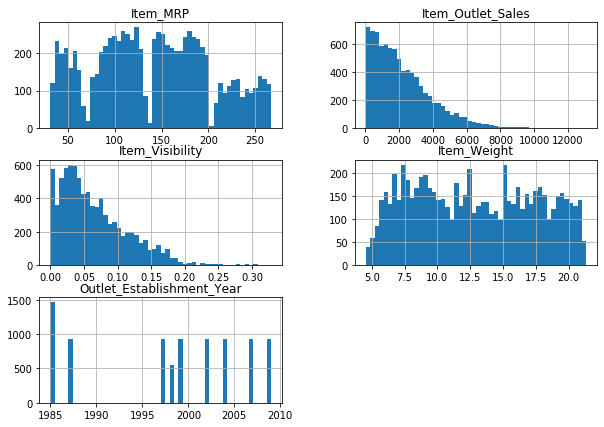

In [34]:
%matplotlib inline
import matplotlib.pyplot as plt
sales_data.hist(bins = 50, figsize = (10,7))
plt.show()

In [36]:
print(sales_data['Item_Visibility'].max())
print(sales_data['Item_Visibility'].min())

0.328390948
0.0


Nothing jumps out as warning signs. Outlet_Establishment_Year is obviously a discrete categorical variable.

Couple more points of note:
- Item_Visibility is capped to less than 1 which makes sense based on the description
- The attributes have a very different scales. We will need to scale those fetaures so our ML algorithm behaves nicely
- Item_Visibility and Item_Outlet_Sales both of which are continuous data (almost) are tail-heavy: they extend much farther to the right of the median than to the left. This may make it a bit harder for some machine learning algorithms to detect patterns. We will try transforming these attributes later on to have more bell-shaped distributions

These sales data is from 2013, so we might be able to use years in operation as an indicator variable

# 1.3 Train and Test Split

We have a couple of choices for splitting training and test data. They are:

- Using a randomly shuffled row indices for test/split
- Using identifier for test/split
- Using stratified sampling.

We can test out later on using grid search, which method of splitting training and test data would be the best solution and if the result we get even differes significantly based on how we split our training and test data. For now, let's proceed with first method: using a randomly shuffled row indices for test/split

In [38]:
from sklearn.model_selection import train_test_split
train_set, test_set = train_test_split(sales_data, test_size=0.2, random_state=42)

In [40]:
print(train_set.shape)
print(test_set.shape)

(6818, 12)
(1705, 12)


# 1.4 Discover and Visualize the Data to Gain Insights

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x000002CE4BCE1B08>,
      dtype=object)

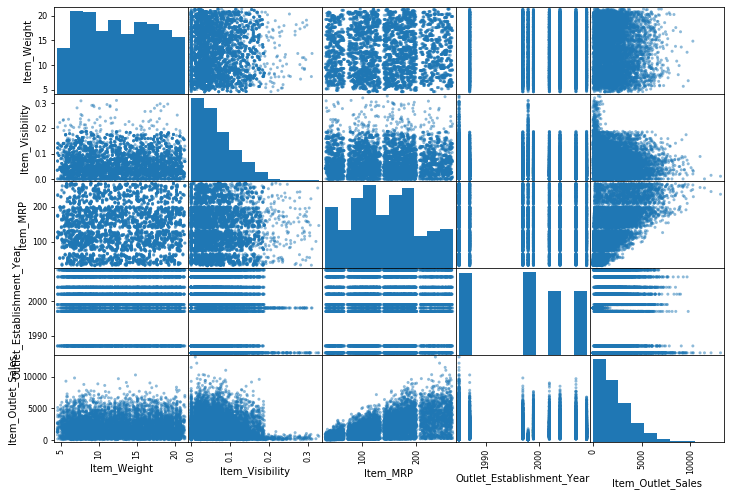

In [42]:
from pandas.plotting import scatter_matrix
attributes = ["Item_Weight", "Item_Visibility", "Item_MRP", "Outlet_Establishment_Year", "Item_Outlet_Sales"]
scatter_matrix(sales_data[attributes], figsize = (12,8))

The main diagonal (top left to bottom right) would be full of straight lines if pandas
plotted each variable against itself, which would not be very useful. So instead pandas
displays a histogram of each attribute (other options are available; see the pandas
documentation for more details).

The most promising attribute to predict the median house value is the median income, so let’s zoom in on their correlation scatterplot (Figure 2-16):

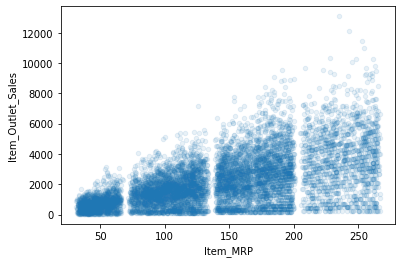

In [44]:
sales_data.plot(kind = "scatter", x = "Item_MRP", y = "Item_Outlet_Sales", alpha = 0.1)

We see that as Item_MRP increases, Item_Outlet_Sales generally incraeses as well.

In [46]:
corr_matrix = sales_data.corr()

In [48]:
corr_matrix["Item_Outlet_Sales"].sort_values(ascending = False)

Item_Outlet_Sales            1.000000
Item_MRP                     0.567574
Item_Weight                  0.014123
Outlet_Establishment_Year   -0.049135
Item_Visibility             -0.128625
Name: Item_Outlet_Sales, dtype: float64

Indeed, Item_Outlet_Sales seems closely related to Item_MRP. The rest of the numerical varaibles in their current state are not helpful

Let's create a column called Outlet_Age which is just 2013 - Outlet_Establishment_Year and see if it does a better job at predicting Item_Outlet_Sales

In [50]:
sales_data_outlet_age = sales_data.copy()
sales_data_outlet_age["Outlet_Age"] = 2013 - sales_data_outlet_age["Outlet_Establishment_Year"]
sales_data_outlet_age.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales,Outlet_Age
0,FDA15,9.30,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380,14
1,DRC01,5.92,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228,4
2,FDN15,17.50,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700,14
3,FDX07,19.20,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,NaN,Tier 3,Grocery Store,732.3800,15
4,NCD19,8.93,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052,26


In [52]:
corr_matrix = sales_data_outlet_age.corr()
corr_matrix["Item_Outlet_Sales"].sort_values(ascending = False)

Item_Outlet_Sales            1.000000
Item_MRP                     0.567574
Outlet_Age                   0.049135
Item_Weight                  0.014123
Outlet_Establishment_Year   -0.049135
Item_Visibility             -0.128625
Name: Item_Outlet_Sales, dtype: float64

Outlet_Age does not do any better of a job. Keep in mind though correlation matrix only looks at linaer relationship. So we will use Outlet_Age as one of the predictors

# 2.0 Prepare The Data for Machine Learning Algorithms

Let's first seperate the labels and predictors first

In [54]:
sales_data_train = train_set.drop("Item_Outlet_Sales", axis = 1)
sales_data_train_labels = train_set["Item_Outlet_Sales"].copy()

Let's also seperate out numerical and non numerical data so we can test drive transformers which are sometimes specific to numerical or categorical data

In [56]:
sales_data_num_attr = ["Item_Weight", "Item_Visibility", "Item_MRP", "Outlet_Establishment_Year"]
sales_data_train_num = sales_data_train[sales_data_num_attr]
sales_data_train_num.head()

,Item_Weight,Item_Visibility,Item_MRP,Outlet_Establishment_Year
549,9.500,0.035206,171.3448,1999
7757,18.000,0.047473,170.5422,2002
764,17.600,0.076122,111.7202,1997
6867,8.325,0.029845,41.6138,2002
2716,12.850,0.137228,155.5630,1997


In [58]:
sales_data_cat_attr = ["Item_Identifier", "Item_Fat_Content", "Item_Type", "Outlet_Identifier", "Outlet_Size", "Outlet_Location_Type", "Outlet_Type"]
sales_data_train_cat = sales_data_train[sales_data_cat_attr]
sales_data_train_cat.head()

,Item_Identifier,Item_Fat_Content,Item_Type,Outlet_Identifier,Outlet_Size,Outlet_Location_Type,Outlet_Type
549,FDW44,Regular,Fruits and Vegetables,OUT049,Medium,Tier 1,Supermarket Type1
7757,NCF54,Low Fat,Household,OUT045,NaN,Tier 2,Supermarket Type1
764,FDY03,Regular,Meat,OUT046,Small,Tier 1,Supermarket Type1
6867,FDQ20,Low Fat,Fruits and Vegetables,OUT045,NaN,Tier 2,Supermarket Type1
2716,FDP34,Low Fat,Snack Foods,OUT046,Small,Tier 1,Supermarket Type1


## 2.1 Dealing with Numerical Data

### 2.1.1 Dealing With Missing Data in Item_Weight

Okay. Now, let's take a look at Item_Weight. It has missing values too (about 1500). A common strategy would be to use simple imputing strategy: using mean or median of the full training set to replace missing values. But a better choice might be to use mean and median of the category it is in for Item_Type or the first two letter code in Item_Identifier

In [60]:
sales_data["Item_Type"].value_counts()

Fruits and Vegetables    1232
Snack Foods              1200
Household                 910
Frozen Foods              856
Dairy                     682
Canned                    649
Baking Goods              648
Health and Hygiene        520
Soft Drinks               445
Meat                      425
Breads                    251
Hard Drinks               214
Others                    169
Starchy Foods             148
Breakfast                 110
Seafood                    64
Name: Item_Type, dtype: int64

Let's use multiple violin plot to look at item weight's distribution based on Item_Type

[Text(0, 0, 'Dairy'),
 Text(0, 0, 'Soft Drinks'),
 Text(0, 0, 'Meat'),
 Text(0, 0, 'Fruits and Vegetables'),
 Text(0, 0, 'Household'),
 Text(0, 0, 'Baking Goods'),
 Text(0, 0, 'Snack Foods'),
 Text(0, 0, 'Frozen Foods'),
 Text(0, 0, 'Breakfast'),
 Text(0, 0, 'Health and Hygiene'),
 Text(0, 0, 'Hard Drinks'),
 Text(0, 0, 'Canned'),
 Text(0, 0, 'Breads'),
 Text(0, 0, 'Starchy Foods'),
 Text(0, 0, 'Others'),
 Text(0, 0, 'Seafood')]

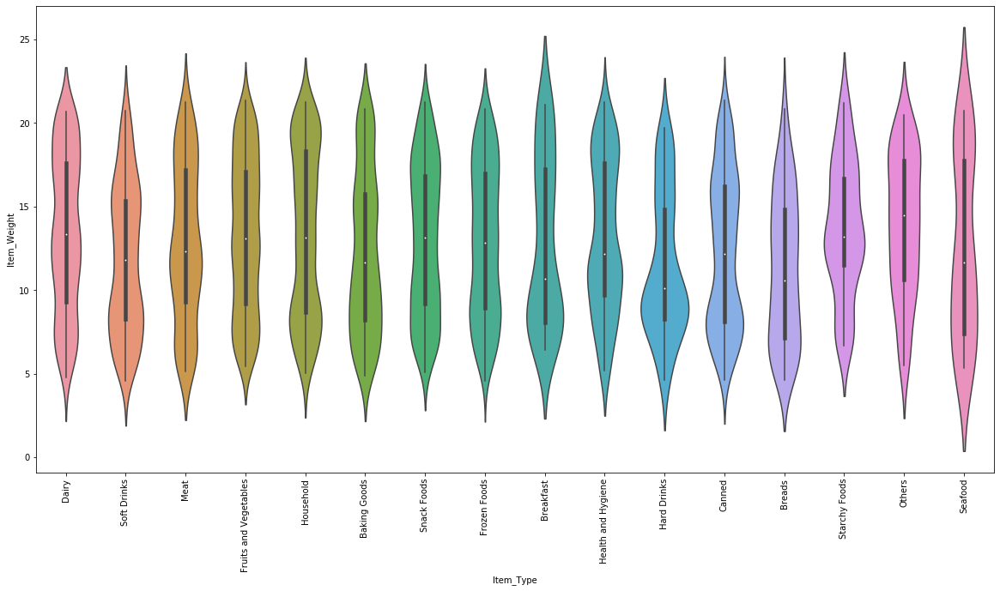

In [62]:
import seaborn as sb
import matplotlib.pyplot as plt
fig = plt.figure(figsize = (20,10))
ax1 = sb.violinplot(data = sales_data, x = 'Item_Type', y = 'Item_Weight')
ax1.set_xticklabels(ax1.get_xticklabels(), rotation = 90)

It seems that Item_Weight varies based on Item_Type. Let's use percentiles to make sure.

In [64]:
def numr_col_quantile_by_category(dataframe, num_col_name, cat_col_name, quantiles = [0.25, 0.5, 0.75]):
    categories = dataframe[cat_col_name].unique()
    for category in categories:
        print("Quartiles for " + num_col_name + " For Category: " + category)
        print(dataframe.loc[dataframe[cat_col_name] == category, num_col_name].quantile(quantiles))
        print(" ")

In [66]:
numr_col_quantile_by_category(sales_data, "Item_Weight", "Item_Type")

Quartiles for Item_Weight For Category: Dairy
0.25     9.2775
0.50    13.3500
0.75    17.6000
Name: Item_Weight, dtype: float64
 
Quartiles for Item_Weight For Category: Soft Drinks
0.25     8.26
0.50    11.80
0.75    15.35
Name: Item_Weight, dtype: float64
 
Quartiles for Item_Weight For Category: Meat
0.25     9.30
0.50    12.35
0.75    17.20
Name: Item_Weight, dtype: float64
 
Quartiles for Item_Weight For Category: Fruits and Vegetables
0.25     9.195
0.50    13.100
0.75    17.100
Name: Item_Weight, dtype: float64
 
Quartiles for Item_Weight For Category: Household
0.25     8.695
0.50    13.150
0.75    18.350
Name: Item_Weight, dtype: float64
 
Quartiles for Item_Weight For Category: Baking Goods
0.25     8.235
0.50    11.650
0.75    15.750
Name: Item_Weight, dtype: float64
 
Quartiles for Item_Weight For Category: Snack Foods
0.25     9.195
0.50    13.150
0.75    16.850
Name: Item_Weight, dtype: float64
 
Quartiles for Item_Weight For Category: Frozen Foods
0.25     8.935
0.50    

Let's try the same exercise using the the first two letter of Item_Identifier

In [68]:
sales_data_item_consume_id = sales_data.copy()
sales_data_item_consume_id["Item Consume ID"] = sales_data_item_consume_id["Item_Identifier"].astype(str).str[0:2]
sales_data_item_consume_id.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales,Item Consume ID
0,FDA15,9.30,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380,FD
1,DRC01,5.92,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228,DR
2,FDN15,17.50,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700,FD
3,FDX07,19.20,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,NaN,Tier 3,Grocery Store,732.3800,FD
4,NCD19,8.93,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052,NC


[Text(0, 0, 'FD'), Text(0, 0, 'DR'), Text(0, 0, 'NC')]

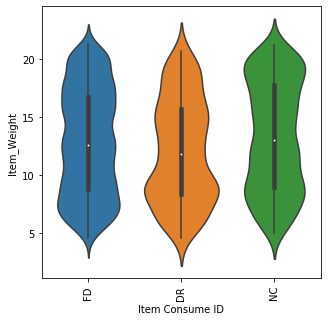

In [70]:
fig = plt.figure(figsize = (5,5))
ax2 = sb.violinplot(data = sales_data_item_consume_id, x = 'Item Consume ID', y = 'Item_Weight')
ax2.set_xticklabels(ax2.get_xticklabels(), rotation = 90)

In [72]:
numr_col_quantile_by_category(sales_data_item_consume_id, 'Item_Weight', 'Item Consume ID')

Quartiles for Item_Weight For Category: FD
0.25     8.77
0.50    12.60
0.75    16.75
Name: Item_Weight, dtype: float64
 
Quartiles for Item_Weight For Category: DR
0.25     8.365
0.50    11.800
0.75    15.700
Name: Item_Weight, dtype: float64
 
Quartiles for Item_Weight For Category: NC
0.25     9.00
0.50    13.00
0.75    17.75
Name: Item_Weight, dtype: float64
 


Later on, we can use grid search to determine whether a simple imputation strategy whwere we simply replace Item_Weight with median of the whole dataset is better strategy than imputing with median of group that item belongs to using either Item Consumable Type or Item_Type. For now, let's replace all the missing values in Item_Weight using median of the whole training data set

In [74]:
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(strategy = "median")

In [76]:
X = imputer.fit_transform(sales_data_train_num)

In [78]:
sales_data_train_num_imp = pd.DataFrame(X, columns = sales_data_num_attr, index = sales_data_train_num.index)
sales_data_train_num_imp.head()

,Item_Weight,Item_Visibility,Item_MRP,Outlet_Establishment_Year
549,9.500,0.035206,171.3448,1999.0
7757,18.000,0.047473,170.5422,2002.0
764,17.600,0.076122,111.7202,1997.0
6867,8.325,0.029845,41.6138,2002.0
2716,12.850,0.137228,155.5630,1997.0


In [80]:
print(sales_data_train_num_imp["Item_Weight"].isnull().sum())
print(sales_data_train_num["Item_Weight"].isnull().sum())


0
1174


We also need to add Outlet_Age to our numerical dataframe. 

We would usually want our custom transformers to work seamless with Scikit_learn functionalities (such as pipelines). Since, Scikit-Learn relies on duck typing (not inheritance), all you need to do is create a class and implement three methods: fit() (returning self), transform() and fit_transform()

You can get the last one for free by simply adding TransformerMixin as a base class

In [106]:
import numpy as np
from sklearn.base import BaseEstimator, TransformerMixin
outlet_age_column_number = sales_data_train_num.columns.get_loc("Outlet_Establishment_Year")

class OutletAgeAdderOld(BaseEstimator, TransformerMixin):
    def __init__(self, column_num, current_year):
        self.column_num = column_num
        self.current_year = current_year
    def fit(self, X, y = None):
        return self
    def transform(self, X):
        outlet_age = self.current_year - X[:, self.column_num]
        #replacing Outlet_Establishment_Year with Outlet_Age
        return np.c_[X[:, :self.column_num], outlet_age, X[:, self.column_num + 1:]]

In [107]:
class OutletAgeAdder(BaseEstimator, TransformerMixin):
    def __init__(self, current_year):
        self.current_year = current_year
    def fit(self, X, y = None):
        return self
    def transform(self, X):
        outlet_age = self.current_year - X
        return outlet_age

In [109]:
sales_data_train["Outlet_Establishment_Year"].values

array([1999, 2002, 1997, ..., 2002, 2007, 1997], dtype=int64)

In [110]:
#Test drive the OutletAgeAdder
outlet_age_adder = OutletAgeAdder(2013)
sales_data_train_num_outlet_age = outlet_age_adder.fit_transform(sales_data_train["Outlet_Establishment_Year"].values)

In [111]:
sales_data_train_num_outlet_age

array([14, 11, 16, ..., 11,  6, 16], dtype=int64)

Now, let's create a pipeline for transforming numerical data. We will also apply scaling features at this stage

In [117]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

num_pipeline = Pipeline([
    ('imputer', SimpleImputer(strategy="median")),
    ('outlet_age_adder', OutletAgeAdder(2013)),
    ('std_scaler', StandardScaler()),
    ])
    
#Full transformation of numerical data
sales_data_train_num_trnsform = num_pipeline.fit_transform(sales_data_train_num)

In [171]:
sales_data_train.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type
549,FDW44,9.500,Regular,0.035206,Fruits and Vegetables,171.3448,OUT049,1999,Medium,Tier 1,Supermarket Type1
7757,NCF54,18.000,Low Fat,0.047473,Household,170.5422,OUT045,2002,NaN,Tier 2,Supermarket Type1
764,FDY03,17.600,Regular,0.076122,Meat,111.7202,OUT046,1997,Small,Tier 1,Supermarket Type1
6867,FDQ20,8.325,Low Fat,0.029845,Fruits and Vegetables,41.6138,OUT045,2002,NaN,Tier 2,Supermarket Type1
2716,FDP34,12.850,Low Fat,0.137228,Snack Foods,155.5630,OUT046,1997,Small,Tier 1,Supermarket Type1


In [118]:
sales_data_train_num_trnsform

array([[ 0.78945628,  0.60070308, -0.47070929, -0.13616916],
       [-1.22142058,  0.36215854, -0.45787656, -0.49352147],
       [-1.12679108, -0.19493285,  0.48262534,  0.10206572],
       ...,
       [-1.12679108,  0.91693149, -1.52620691, -0.49352147],
       [-1.77736889,  0.22818684,  0.38307175, -1.08910867],
       [-0.8310739 ,  0.95485942,  0.73811593,  0.10206572]])

In [119]:
sales_data_train_num_trnsform.shape

(6818, 4)

We have 4 columns as expected.

## 2.2 Dealing With Categorical Data

In [87]:
sales_data_train_cat.head()

,Item_Identifier,Item_Fat_Content,Item_Type,Outlet_Identifier,Outlet_Size,Outlet_Location_Type,Outlet_Type
549,FDW44,Regular,Fruits and Vegetables,OUT049,Medium,Tier 1,Supermarket Type1
7757,NCF54,Low Fat,Household,OUT045,NaN,Tier 2,Supermarket Type1
764,FDY03,Regular,Meat,OUT046,Small,Tier 1,Supermarket Type1
6867,FDQ20,Low Fat,Fruits and Vegetables,OUT045,NaN,Tier 2,Supermarket Type1
2716,FDP34,Low Fat,Snack Foods,OUT046,Small,Tier 1,Supermarket Type1


There are couple of transformations to do here. First:

- Item_Identifier: Replace this column with a column which just takes the first two letters of each Item_Identifier value. We then need to use one hot encoding for each of those categories (total of 3 categories)

- Item_Fat_Content:  As stated before, this column is used to keep track of whether an item is low fat or not. We can replace it with a simple binary field where 1 corresponds to Low Fat and 0 corresponds to non low fat food

- Item_Type: One hot encoding

- Outlet_Identifier: One hot encoding

- Outlet_Size: Figure out a impute strategy and then once imptuation is done, use ordinal encoding

- Outlet_Location_Type: ordinal encoding

- Outlet_Type: 1 hot encoding


### 2.2.1 Transforming Item_Identifier

In [120]:
#Tansforming Item_Identifier
class ItemIdTransform(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass

    def fit(self, X, y = None):
        return self
    
    def transform(self, X):
        id_transform = np.zeros(shape = (X.shape[0], 1)).astype(str)
        X = X.copy().astype(str)
        for row in range(0, X.shape[0]):
            id_transform[row] = X[row][0:2]
        return id_transform

In [128]:
#Test drive Item_Identifier
item_id_transform = ItemIdTransform()
sales_data_train["Item_Identifier"]
item_id_trnsfrm = item_id_transform.fit_transform(sales_data_train["Item_Identifier"].values)
item_id_trnsfrm


array([['FD'],
       ['NC'],
       ['FD'],
       ...,
       ['NC'],
       ['FD'],
       ['NC']], dtype='<U32')

### 2.2.2 Transforming Item_Fat_Content

In [51]:
sales_data_train_cat["Item_Fat_Content"].value_counts()

Low Fat    4035
Regular    2336
LF          267
reg          93
low fat      87
Name: Item_Fat_Content, dtype: int64

In [132]:
class ItemFatContentTrnsfrm(BaseEstimator, TransformerMixin):
    def __init__(self, replcm_dict):
        self.replcm_dict = replcm_dict
    
    def fit(self, X, y = None):
        return self
    
    def transform(self, X):
        #Tips from here:https://stackoverflow.com/questions/3403973/fast-replacement-of-values-in-a-numpy-array
        fat_content_trnsfrm = X.copy()
        for k, v in self.replcm_dict.items():
            fat_content_trnsfrm[fat_content_trnsfrm == k] = v
        return fat_content_trnsfrm.astype(int)

In [133]:
#Test drive Item_Fat_Content transformer
item_fat_content_replcm_dict = {'Low Fat': 1, 'Regular': 0, 'LF': 1, 'reg': 0, 'low fat' : 1}
item_fat_content_transform = ItemFatContentTrnsfrm(item_fat_content_replcm_dict)
item_fat_content_trnsfrm = item_fat_content_transform.fit_transform(sales_data_train["Item_Fat_Content"].values)
item_fat_content_trnsfrm

array([0, 1, 0, ..., 1, 1, 1])

We can see that the second column (starting at 1) has zeroe and ones now. So transformation was successful

For the rest of the transformation, we will first impute Outlet_Size. Once that is done we will apply one hot encoding and ordinal encoding to the columns we discussed before

### 2.2.3 Dealing With Missing Data in "Outlet_Size"

We noticed from before that there is a quite few missing data for column "Outlet_Size". Although we could simply drop them, let's see if we can come up with a strategy for imputation.

In [55]:
sales_data.loc[sales_data["Outlet_Identifier"] == "OUT010", "Outlet_Size"].value_counts()

Series([], Name: Outlet_Size, dtype: int64)

In [56]:
sales_data.loc[sales_data["Outlet_Identifier"] == "OUT010", "Outlet_Size"]

3       NaN
28      NaN
30      NaN
45      NaN
65      NaN
       ... 
8400    NaN
8432    NaN
8473    NaN
8486    NaN
8509    NaN
Name: Outlet_Size, Length: 555, dtype: object

So, it looks like for some specific outlet, the data "Outlet_Size" is completely missing. Maybe we can take a look at Outlet_Type for clues into "Outlet_Size"

Here are the Outlet_Type again for convenience

In [57]:
sales_data["Outlet_Type"].value_counts()

Supermarket Type1    5577
Grocery Store        1083
Supermarket Type3     935
Supermarket Type2     928
Name: Outlet_Type, dtype: int64

In [58]:
sales_data.loc[sales_data["Outlet_Identifier"] == "OUT010", "Outlet_Type"].value_counts()

Grocery Store    555
Name: Outlet_Type, dtype: int64

So all of "OUT010" which is missing data has outlet_type of Grocery Store. Let's take a look at the all the rows where Outlet_Size is missing and see what the "Outlet_Type" is.

In [59]:
sales_data.loc[sales_data["Outlet_Size"].isnull(), 'Outlet_Type'].value_counts()

Supermarket Type1    1855
Grocery Store         555
Name: Outlet_Type, dtype: int64

So, if we find evidence that for certain Outlet_Type, Outlet_Size is always some value then we can impute values for Outlet_Size confidently. Now, let's see what the Outlet_Size is typically for each Outlet_Type

In [60]:
#Exactly what I need
sales_data.groupby(['Outlet_Type', 'Outlet_Size']).size()

Outlet_Type        Outlet_Size
Grocery Store      Small           528
Supermarket Type1  High            932
                   Medium          930
                   Small          1860
Supermarket Type2  Medium          928
Supermarket Type3  Medium          935
dtype: int64

In [61]:
#Not giving me what I want
#sales_data.pivot_table(index = ['Outlet_Type'], values = 'Outlet_Size', aggfunc =  'count') 
#sales_data.groupby('Outlet_Type').count()

So it seems that all stores with Outlet_Type == "Groccery Store" has "Outlet_Size" of small. 

For Supermarket Type1, the Outlet_Size could be High or Medium or Small. So, this is not as helpful. 

Perhaps we can randomly generate "High", "Medium" or "Small" for "Outlet_Size" based on their probaiblity for SuperMarket Type1 using the function below

In [62]:
#This function generates 'x' with probability px/100, 'y' with 
#probability py/100  and 'z' with probability pz/100:
#Assumption: px + py + pz = 100 where px, py and pz lie 
#between 0 to 100 
#https://www.geeksforgeeks.org/write-a-function-to-generate-3-numbers-according-to-given-probabilities/
from random import randint
def random_number_generator(x, y, z, px, py, pz):
    
    #generate a number from 1 to 100
    r = randint(1,100)

    #r is smaller than px with probability px/100
    if (r <= px):
        return x
    
    #r is greater than px and smaller than or equal to px+py 
    if (r <= (px + py)):
        return y
    
    #r is greater than px+py and smaller than or equal to 100 
    else:
        return z

We can use grid search to find best strategy between this vs. most_frequent later on. Let's dig a bit more to see if we can use any other columns to impute "Outlet_Size" starting with "Outlet_Establishment_Year". Maybe, we can establish that in one year, all the outlets established were Small, in another year, all the outlets established were Medium and so on

In [63]:
sales_data.groupby(['Outlet_Establishment_Year', 'Outlet_Size']).size()

Outlet_Establishment_Year  Outlet_Size
1985                       Medium         935
                           Small          528
1987                       High           932
1997                       Small          930
1999                       Medium         930
2004                       Small          930
2009                       Medium         928
dtype: int64

So apart from 1985, in every year, only outlets of specific sizes were built. This is promising

In [64]:
sales_data.loc[sales_data["Outlet_Size"].isnull(), 'Outlet_Establishment_Year'].value_counts()

2002    929
2007    926
1998    555
Name: Outlet_Establishment_Year, dtype: int64

It seems that for the rows where "Outlet_Size" is missing, they corresponded to years where we did not record Outlet_Size at all. We need to dig a bit more

In [65]:
sales_data_outlet_size_null = sales_data.loc[sales_data["Outlet_Size"].isnull(), :]

In [66]:
sales_data_outlet_size_null.groupby(['Outlet_Establishment_Year', 'Outlet_Type']).size()

Outlet_Establishment_Year  Outlet_Type      
1998                       Grocery Store        555
2002                       Supermarket Type1    929
2007                       Supermarket Type1    926
dtype: int64

So we got nowhere. We already that when Outlet_Type is Grocery Store, Outlet_Size is small. However, when Outlet_Type is Supermarket Type1, Outlet_Size can be High, Medium, or Small. 

And we already established that for the establishment years 1998, 2002, and 2007, we don't have any data on as to what the size of the outlets were. So we can't draw any conclusion from Outlet_Establishment_Year either. 

Let's do a last check with Outlet_Location_Type and see if we can use that to impute Outlet_Size

In [67]:
sales_data["Outlet_Location_Type"].value_counts()

Tier 3    3350
Tier 2    2785
Tier 1    2388
Name: Outlet_Location_Type, dtype: int64

In [68]:
sales_data_outlet_size_null['Outlet_Location_Type'].value_counts()

Tier 2    1855
Tier 3     555
Name: Outlet_Location_Type, dtype: int64

In [69]:
sales_data_outlet_size_null.groupby(['Outlet_Location_Type', 'Outlet_Type']).size()

Outlet_Location_Type  Outlet_Type      
Tier 2                Supermarket Type1    1855
Tier 3                Grocery Store         555
dtype: int64

All tier 3 location type is grocery store. We already know how to impute them based on grocery store so we don't gain value from this

Tier 2 is always supermarket type1 and we can't impute based of that

In [70]:
sales_data.groupby(['Outlet_Location_Type', 'Outlet_Type', 'Outlet_Size']).size()

Outlet_Location_Type  Outlet_Type        Outlet_Size
Tier 1                Grocery Store      Small          528
                      Supermarket Type1  Medium         930
                                         Small          930
Tier 2                Supermarket Type1  Small          930
Tier 3                Supermarket Type1  High           932
                      Supermarket Type2  Medium         928
                      Supermarket Type3  Medium         935
dtype: int64

In [71]:
sales_data.loc[sales_data['Outlet_Location_Type'] == 'Tier 2', :].shape

(2785, 12)

In conclusion, for all the outlet_size missing, we simply have to replace them with "Small". We can create more robust logic later but for now, this will suffice.

In [135]:
class OutletSizeImpute(BaseEstimator, TransformerMixin):
    def __init__(self, replcm_val):
        self.replcm_val = replcm_val
    
    def fit(self, X, y = None):
        return self
    
    def transform(self, X):
        #Solution Link: https://www.codegrepper.com/code-examples/python/numpy+ndarray+fillna
        #Could not use the solution above because of mixed type in ndarray

        #Convert all to Str
        outlet_size_trnsfrm = X.copy().astype(str)
        outlet_size_trnsfrm[outlet_size_trnsfrm == 'nan'] = self.replcm_val
        return outlet_size_trnsfrm


In [136]:
sales_data_train["Outlet_Size"].values

array(['Medium', nan, 'Small', ..., nan, nan, 'Small'], dtype=object)

In [138]:
#Test Drive Outlet_Size Imputer
outlet_size_imp =  OutletSizeImpute("Small")
outlet_size_imp = outlet_size_imp.fit_transform(sales_data_train["Outlet_Size"].values)
outlet_size_imp

array(['Medium', 'Small', 'Small', ..., 'Small', 'Small', 'Small'],
      dtype='<U6')

The second row had null for Outlet_Size. We have "small" now. So the transformation was successful

### 2.2.5 Ordinal Encoding

Let's do Ordinal Encoding first. Recall that we will use oridnal encoding for Outlet_Size and Outlet_Location_Type

In [140]:
sales_data_train["Outlet_Size"].value_counts()

Medium    2233
Small     1906
High       744
Name: Outlet_Size, dtype: int64

In [139]:
sales_data_train["Outlet_Location_Type"].value_counts()

Tier 3    2703
Tier 2    2239
Tier 1    1876
Name: Outlet_Location_Type, dtype: int64

In [147]:
#Small will be encoded as 0, Medium as 1 and High as 2
outlet_size_ord_catgs = ['Small', 'Medium', 'High']
#Tier 1 will be encoded as 0, Tier 2 as 1 and Tier 3 as 2
outlet_location_type_ord_catgs = ['Tier 1', 'Tier 2', 'Tier 3']

In [148]:
from sklearn.preprocessing import OrdinalEncoder
ordinal_encoder = OrdinalEncoder(categories = [outlet_size_ord_catgs, outlet_location_type_ord_catgs]) 

In [150]:
sales_data_train_ord = np.c_[outlet_size_imp, sales_data_train["Outlet_Location_Type"].values]
sales_data_train_ord_encoded = ordinal_encoder.fit_transform(sales_data_train_ord)

In [153]:
sales_data_train_ord

array([['Medium', 'Tier 1'],
       ['Small', 'Tier 2'],
       ['Small', 'Tier 1'],
       ...,
       ['Small', 'Tier 2'],
       ['Small', 'Tier 2'],
       ['Small', 'Tier 1']], dtype=object)

In [152]:
sales_data_train_ord_encoded

array([[1., 0.],
       [0., 1.],
       [0., 0.],
       ...,
       [0., 1.],
       [0., 1.],
       [0., 0.]])

### 2.2.6 One Hot Encoding

We need to one hot encode, Item_Identifier, Item_Type, Outlet_Identifier, Outlet_Type

We don't want to use the last 3 digit of the outlet_identifier as a feature because the ML algorithm might learn that Outlet_Identifier implies some sort of order which of course it does not

In [157]:
cat_1hot_categories = ['Item_Type', 'Outlet_Identifier', 'Outlet_Type']
np.c_[item_id_trnsfrm, sales_data_train[cat_1hot_categories].values]





array([['FD', 'Fruits and Vegetables', 'OUT049', 'Supermarket Type1'],
       ['NC', 'Household', 'OUT045', 'Supermarket Type1'],
       ['FD', 'Meat', 'OUT046', 'Supermarket Type1'],
       ...,
       ['NC', 'Health and Hygiene', 'OUT045', 'Supermarket Type1'],
       ['FD', 'Snack Foods', 'OUT017', 'Supermarket Type1'],
       ['NC', 'Household', 'OUT046', 'Supermarket Type1']], dtype=object)

In [155]:
sales_data_train["Item_Type"]

549     Fruits and Vegetables
7757                Household
764                      Meat
6867    Fruits and Vegetables
2716              Snack Foods
                ...          
5734    Fruits and Vegetables
5191             Frozen Foods
5390       Health and Hygiene
860               Snack Foods
7270                Household
Name: Item_Type, Length: 6818, dtype: object

In [160]:
from sklearn.preprocessing import OneHotEncoder
cat_encoder = OneHotEncoder()
cat_1hot_categories = ['Item_Type', 'Outlet_Identifier', 'Outlet_Type']
sales_data_train_1hot = cat_encoder.fit_transform(np.c_[item_id_trnsfrm, sales_data_train[cat_1hot_categories].values])
sales_data_train_1hot.toarray()

array([[0., 1., 0., ..., 1., 0., 0.],
       [0., 0., 1., ..., 1., 0., 0.],
       [0., 1., 0., ..., 1., 0., 0.],
       ...,
       [0., 0., 1., ..., 1., 0., 0.],
       [0., 1., 0., ..., 1., 0., 0.],
       [0., 0., 1., ..., 1., 0., 0.]])

In [161]:
sales_data_train_1hot.toarray().shape

(6818, 33)

In [162]:
cat_encoder.categories_

[array(['DR', 'FD', 'NC'], dtype=object),
 array(['Baking Goods', 'Breads', 'Breakfast', 'Canned', 'Dairy',
        'Frozen Foods', 'Fruits and Vegetables', 'Hard Drinks',
        'Health and Hygiene', 'Household', 'Meat', 'Others', 'Seafood',
        'Snack Foods', 'Soft Drinks', 'Starchy Foods'], dtype=object),
 array(['OUT010', 'OUT013', 'OUT017', 'OUT018', 'OUT019', 'OUT027',
        'OUT035', 'OUT045', 'OUT046', 'OUT049'], dtype=object),
 array(['Grocery Store', 'Supermarket Type1', 'Supermarket Type2',
        'Supermarket Type3'], dtype=object)]

Let's build the full pipeline for transforming full dataset




## 2.3 Full Transformation Pipeline

See the python file